# Historical Map of Barcelona - Classification
---

John Searight

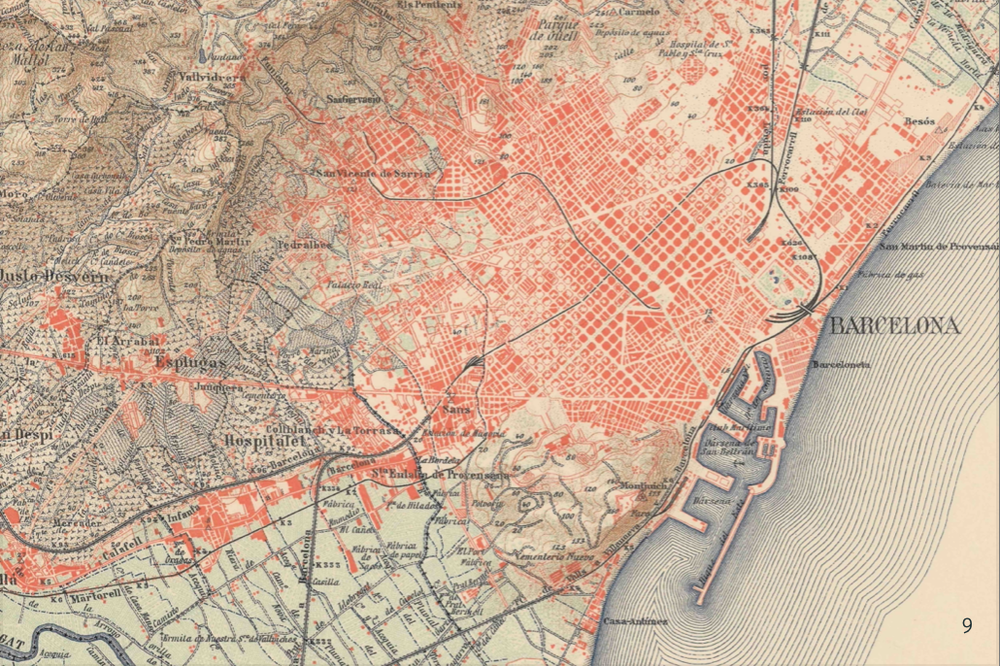

## 0. Intro

I focused on tree based methods to try and improve upon the classification of the given map of Barcelona. Decision trees will continously segment the input space into partitions until a stopping criteria is met, at which point a prediction will be made.

The algorithms will be predicting the following: '0', 'buildings', 'crops', 'meadows', 'pastures', 'specialised', 'forests', 'water', 'roads'

As you will see in the notebook below, the initial predictions were not accurate. 

Thus, I took various steps to improve our prediction accuaracy: 

1.   Naive Random Forest and tuned Random Forest
1.   XGBoost
1.   Randomized Search CV across all tree-based methods in order to select optimal parameters 
1. Gradient Boosting Classifier
1. Accounted for class-imbalance by using class weights and SMOTE

These methods did not result in a significant increase in our prediction accuracy or F1 scores however yielded slightly better results overall. Notably when we dealt with class imbalance our models were better able to pick up buildings. In the notebook below you will find the code and predictions for each of our attempts at improving the predictions. The final aspect of the notebook looks at all predictions visually compared against one another. 

In [ ]:
# clear everything
%reset -f
print(dir())

['In', 'Out', '__builtin__', '__builtins__', '__name__', '_dh', '_ih', '_oh', '_sh', 'exit', 'get_ipython', 'quit']


In [ ]:
# Mount G Drive
from google.colab import drive
drive.mount('/content/drive')

# Set path
import os
os.chdir('/content/drive/MyDrive/Text_Mining/Geospatial Analysis/Clement/practice_maps.zip (Unzipped Files)/practice_maps/')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install rasterio

     |████████████████████████████████| 19.3 MB 360 kB/s 


In [ ]:
# Modules
import numpy as np
import pandas as pd

#from functools import reduce
import functools
from functools import reduce
from scipy import ndimage
from sklearn import ensemble
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, plot_confusion_matrix, ConfusionMatrixDisplay
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.model_selection import RandomizedSearchCV, cross_val_score

from maps_utilities import *
#from maps_utilities import *

#%% MODULES

import rasterio
import os
import re
import seaborn as sns
from matplotlib import pyplot as plt

import xgboost
from xgboost import XGBClassifier

from datetime import datetime

# TensorFlow
import tensorflow as tf
print("TensorFlow version:", tf.__version__)
print("GPU Available:", len(tf.config.experimental.list_physical_devices('GPU')))

TensorFlow version: 2.8.0
GPU Available: 0


# **0. Custom Functions**

Note I do not use all of the functions below but have included them here for sake of ease if we circle back to this notebook

In [ ]:
#%% FUNCTIONS

# Lists files in a directory that match a regular expression
def search_files(directory:str, pattern:str='.') -> list:
    files = list()
    for root, _, file_names in os.walk(directory):
        for file_name in file_names:
            files.append(os.path.join(root, file_name))
    files = list(filter(re.compile(pattern).search, files))
    files.sort()
    return files

# Reads a raster as a numpy array
def read_raster(source:str, dtype:type=np.uint8) -> np.ndarray:
    raster = rasterio.open(source)
    raster = raster.read()
    image  = raster.transpose([1, 2, 0]).astype(dtype)
    return image

# Writes a numpy array to a raster
def write_raster(image:np.ndarray, source:str, destination:str, nodata:int=0, dtype:str='uint8') -> None:
    raster  = image.transpose([2, 0, 1]).astype(dtype)
    profile = rasterio.open(source).profile
    profile.update(dtype=dtype, count=raster.shape[0], nodata=nodata)
    with rasterio.open(destination, 'w', **profile) as dest:
        dest.write(raster)

# Displays an image
def display(image:np.ndarray, title:str='', cmap:str='gray') -> None:
    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(image, cmap=cmap)
    ax.set_title(title, fontsize=20)
    ax.set_axis_off()
    plt.tight_layout()
    plt.show()

# Displays multiple images
def compare(images:list, titles:list=['Image'], cmaps:list=['gray']) -> None:
    nimage = len(images)
    if len(titles) == 1:
        titles = titles * nimage
    if len(cmaps) == 1:
        cmaps = cmaps * nimage
    fig, axs = pyplot.subplots(nrows=1, ncols=nimage, figsize=(10, 10 * nimage))
    for ax, image, title, cmap in zip(axs.ravel(), images, titles, cmaps):
        ax.imshow(image, cmap=cmap)
        ax.set_title(title, fontsize=15)
        ax.set_axis_off()
    pyplot.tight_layout
    plt.show()

# Computes the median intensity of each segment for each channel
def segment_median(image:np.ndarray, segment:np.ndarray) -> np.ndarray:
    nsegment = len(np.unique(segment))
    channels = np.dsplit(image, image.shape[-1])
    medians  = [ndimage.median(channel, labels=segment, index=np.arange(1, nsegment + 1)) for channel in channels]
    medians  = np.column_stack(medians)
    return medians

# Computes the most common value in each segment
def segment_argmax(label:np.ndarray, segment:np.ndarray) -> np.ndarray:
    table  = pd.DataFrame({'segment': segment.flatten(), 'label': label.flatten()})
    table  = pd.crosstab(table.segment, table.label)
    argmax = table.idxmax(axis=1).to_numpy()
    return argmax

def predict_image(image, segment, mask):
    X     = segment_median(image, segment)
    label = rf.predict(X)
    label = label[segment - 1]
    label = np.where(mask, label, 0)
    return label

def confusion_matrix(label:np.ndarray, predicted:np.ndarray) -> pd.DataFrame:
    keep    = np.where(label != 0)
    confmat = pd.DataFrame({'label': label[keep], 'predicted': predicted[keep]})
    confmat = pd.crosstab(confmat.label, confmat.predicted, margins=False)
    confmat = confmat.reindex(index=classes.keys(), columns=classes.keys(), fill_value=0)
    confmat = confmat.rename(index=classes, columns=classes)
    return confmat

def statistics(confmat:pd.DataFrame) -> tuple:
    recall    = confmat.divide(confmat.sum(axis=1), axis=0)
    precision = confmat.divide(confmat.sum(axis=0), axis=1)
    # Formats
    for data in recall, precision:
        data.loc['Total', :] = data.sum(axis=0)
        data.loc[:, 'Total'] = data.sum(axis=1)
    return precision, recall
  
def cfmatrix(cf_matrix, ytest, yhat):
    cf_matrix =  confusion_matrix(ytest, yhat)

    group_counts = ["{0:0.0f}".format(value) for value in
                    cf_matrix.flatten()]

    group_percentages = ["{0:.2%}".format(value) for value in
                        cf_matrix.flatten()/np.sum(cf_matrix)]

    labels = [f"{v1}\n{v2}\n" for v1, v2 in
              zip(group_counts,group_percentages)]

    labels = np.asarray(labels).reshape(9,9)

    fig, ax = plt.subplots(figsize=(15,10)) 
    ax = sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='summer')

    ax.set_title('Random Forest Confusion Matrix\n\n');
    ax.set_xlabel('\nPredicted')
    ax.set_ylabel('Actual');

    ## Ticket labels - List must be in alphabetical order
    ax.xaxis.set_ticklabels(class_labels_multi)
    ax.yaxis.set_ticklabels(class_labels_multi)

    ## Display the visualization of the Confusion Matrix.
    plt.show()

#%% PREDICTION STATISTICS
labels_predict = list(map(predict_image, images_test, segments_test, masks_test))

def confusion_matrix_custom(label:np.ndarray, predicted:np.ndarray) -> pd.DataFrame:
    keep    = np.where(label != 0)
    confmat = pd.DataFrame({'label': label[keep], 'predicted': predicted[keep]})
    confmat = pd.crosstab(confmat.label, confmat.predicted, margins=False)
    confmat = confmat.reindex(index=classes.keys(), columns=classes.keys(), fill_value=0)
    confmat = confmat.rename(index=classes, columns=classes)
    return confmat

def statistics(confmat:pd.DataFrame) -> tuple:
    recall    = confmat.divide(confmat.sum(axis=1), axis=0)
    precision = confmat.divide(confmat.sum(axis=0), axis=1)
    # Formats
    for data in recall, precision:
        data.loc['Total', :] = data.sum(axis=0)
        data.loc[:, 'Total'] = data.sum(axis=1)
    return precision, recall

# Aggregates confusion matrices
confmat = list(map(confusion_matrix, labels_test, labels_predict))
confmat = functools.reduce(lambda cm1, cm2: cm1.add(cm2), confmat)
recall, precision = statistics(confmat)


# Precision and recall
recall.applymap(lambda value: '{0:.2f} %'.format(value * 100))
precision.applymap(lambda value: '{0:.2f} %'.format(value * 100))

#%% PREDICT IMAGES
labels_predict = list(map(predict_image, images_test, segments_test, masks_test))

# Displays labels and predictions
try:
  for i in np.random.choice(range(len(images_test)), 5, replace=False):
      compare([images_test[i], labels_test[i], labels_predict[i]], ["Image", "Label", "Prediction"])
except:
  pass

# **1. Load Data**

In [ ]:
# Paths
paths = dict(
    images_train = 'data/training_sample/images',
    labels_train = 'data/training_sample/labels',
    segments_train = 'data/training_sample/segments',
    masks_train = 'data/training_sample/masks',
    images_test = 'data/test_sample/images',
    labels_test = 'data/test_sample/labels',
    segments_test = 'data/test_sample/segments',
    masks_test = 'data/test_sample/masks'
)

# Classes
classes = {1:'buildings', 2:'crops', 3:'meadows', 4:'pastures', 5:'specialised', 6:'forests', 7:'water', 8:'roads'}

In [ ]:
import numpy as np
from matplotlib import pyplot
import skimage
from skimage import color, data, exposure, feature, filters, io, morphology, segmentation, transform, util

In [ ]:
#%% LOAD TRAINING DATA
images_train   = [read_raster(file, dtype=np.ubyte)  for file in search_files(paths['images_train'],   pattern='tif$')]
labels_train   = [read_raster(file, dtype=np.ubyte)  for file in search_files(paths['labels_train'],   pattern='tif$')]
segments_train = [read_raster(file, dtype=np.uint16) for file in search_files(paths['segments_train'], pattern='tif$')]
masks_train    = [read_raster(file, dtype=bool)      for file in search_files(paths['masks_train'],    pattern='tif$')]

94


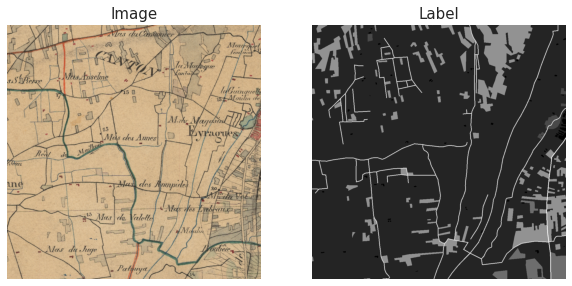

313


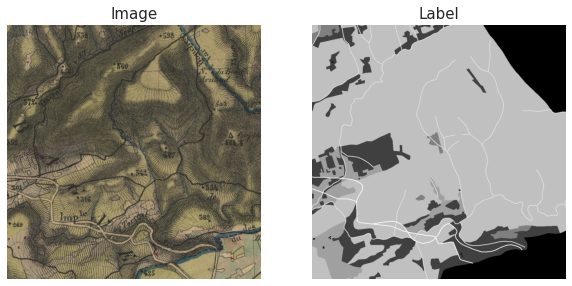

213


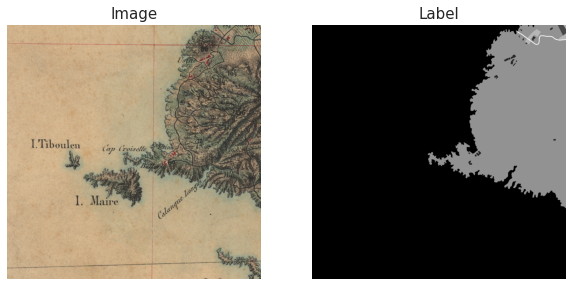

112


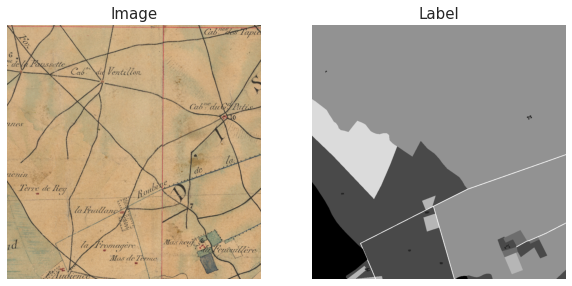

187


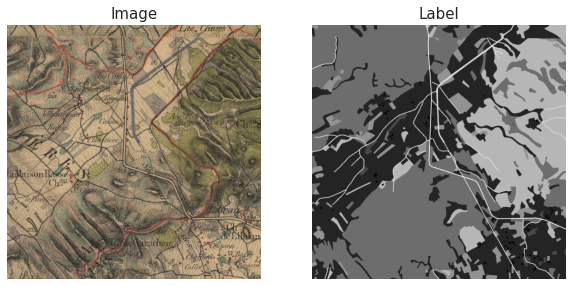

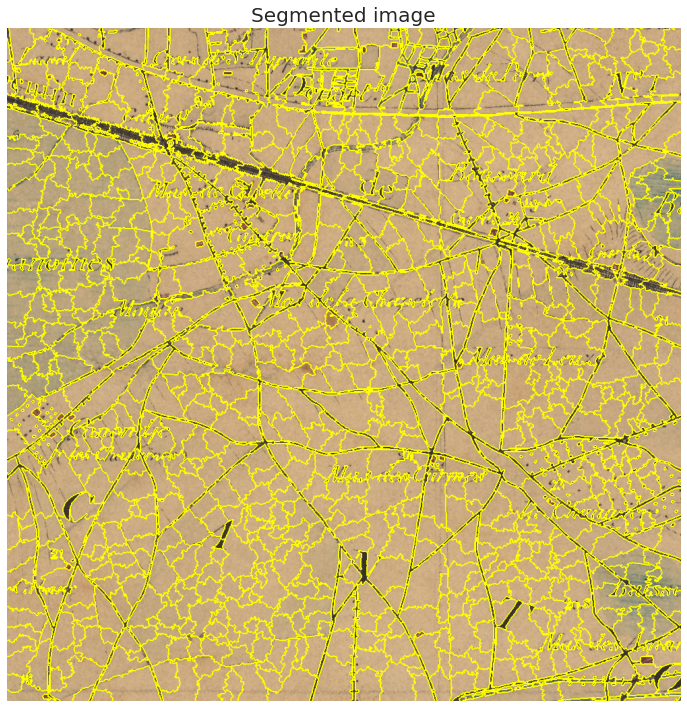

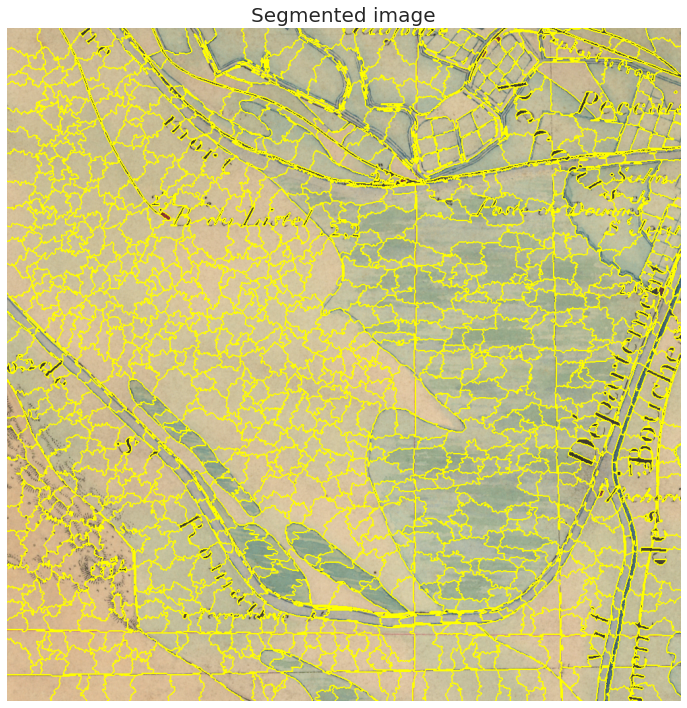

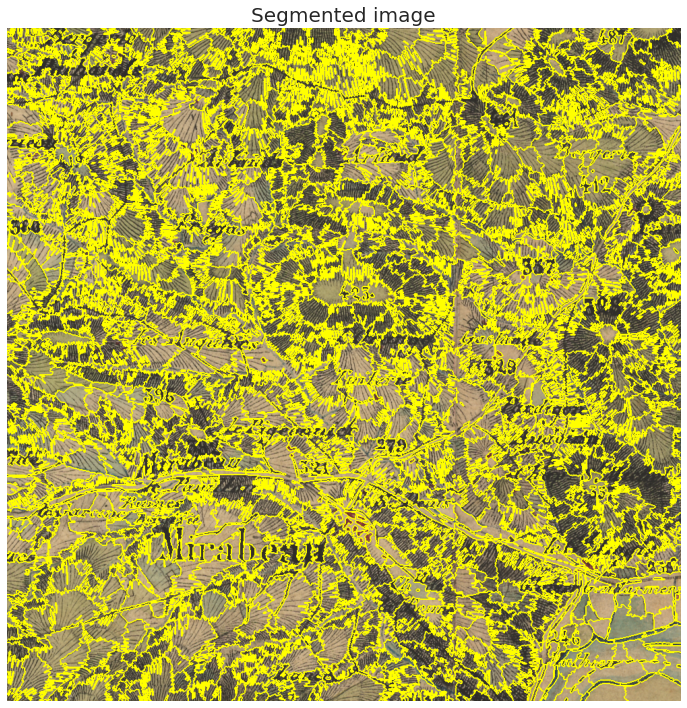

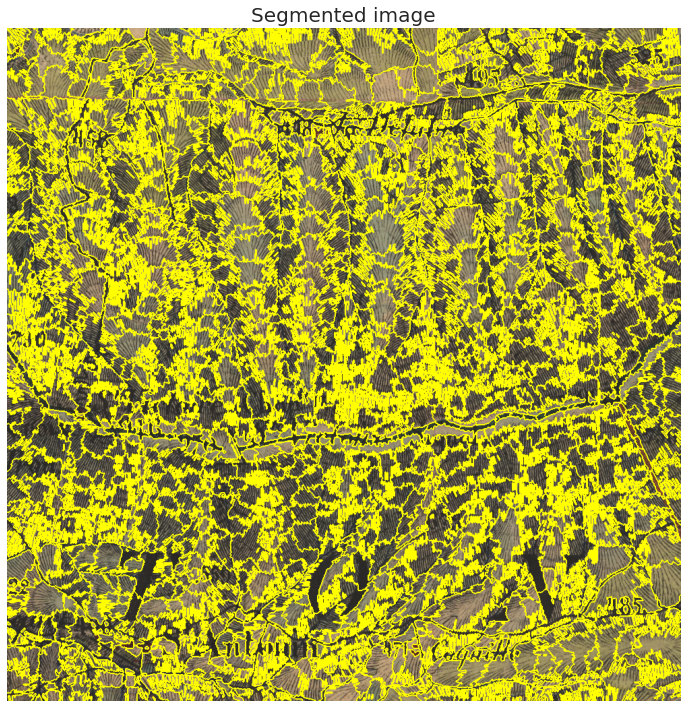

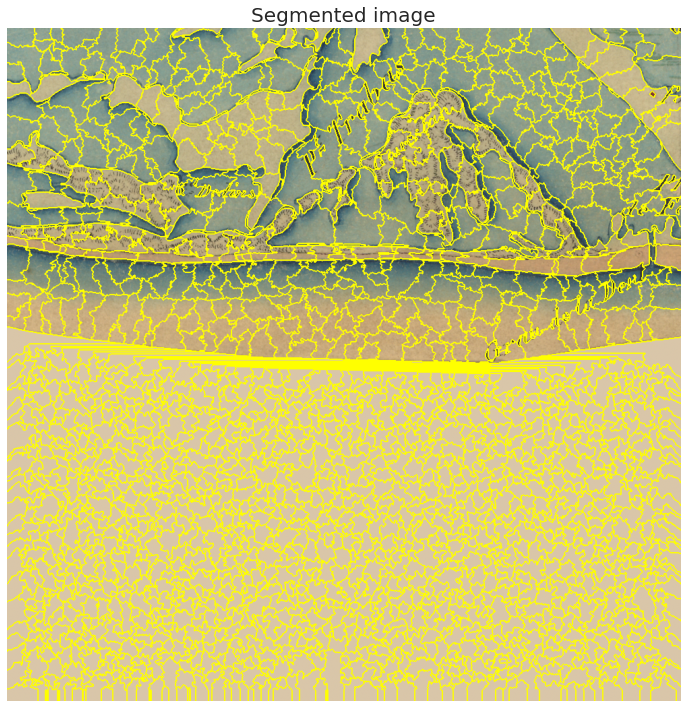

In [ ]:
# DISPLAY TRAINING DATA
#Displays 5 random images and labels
for i in np.random.choice(range(len(images_train)), 5, replace=False):
    print(i)
    #Had to add in these squeezes in order to not get an error
    p = np.squeeze(images_train[i])
    q = np.squeeze(labels_train[i])
    compare(images=[p, q], titles=['Image', 'Label'])

# Displays image segmentation
for i in np.random.choice(range(len(images_train)), 5, replace=False):
    display(image=segmentation.mark_boundaries(images_train[i], np.squeeze(segments_train[i])), title='Segmented image')

In [ ]:
#%% LOADS TEST DATA
images_test   = [read_raster(file, dtype=np.ubyte)  for file in search_files(paths['images_test'],   pattern='tif$')]
labels_test   = [read_raster(file, dtype=np.ubyte)  for file in search_files(paths['labels_test'],   pattern='tif$')]
masks_test    = [read_raster(file, dtype=bool)      for file in search_files(paths['masks_test'],    pattern='tif$')]
segments_test = [read_raster(file, dtype=np.uint16) for file in search_files(paths['segments_test'], pattern='tif$')]

57


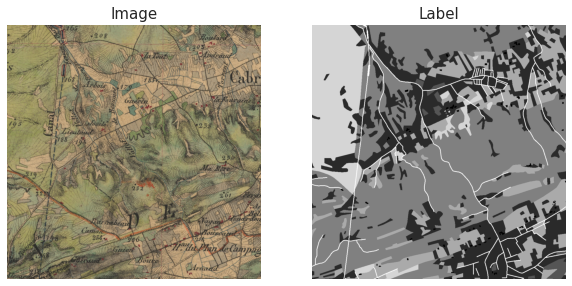

10


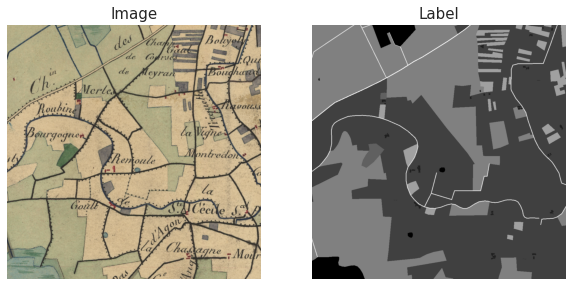

3


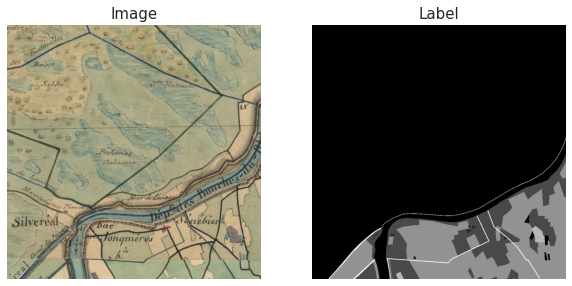

48


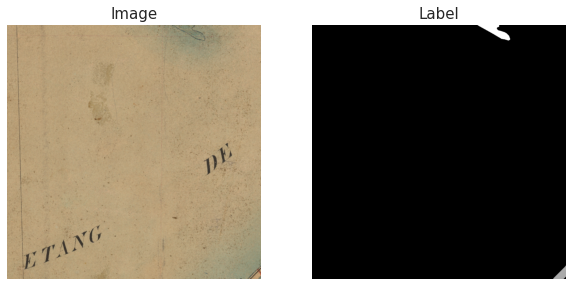

73


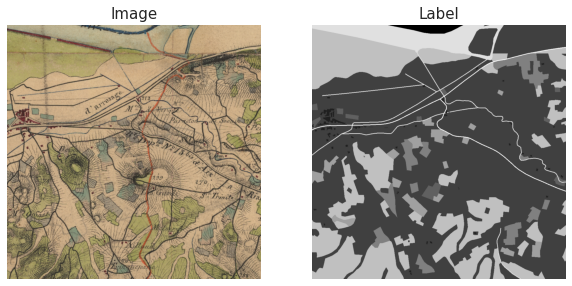

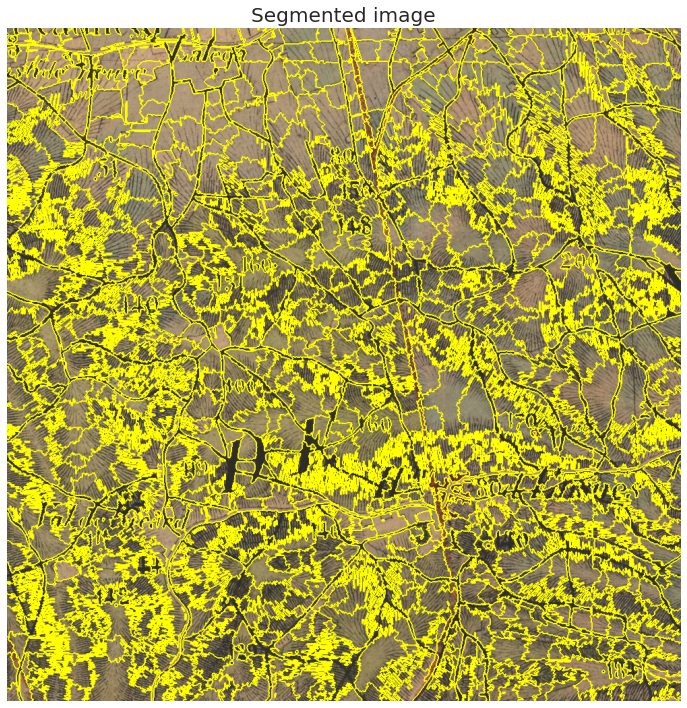

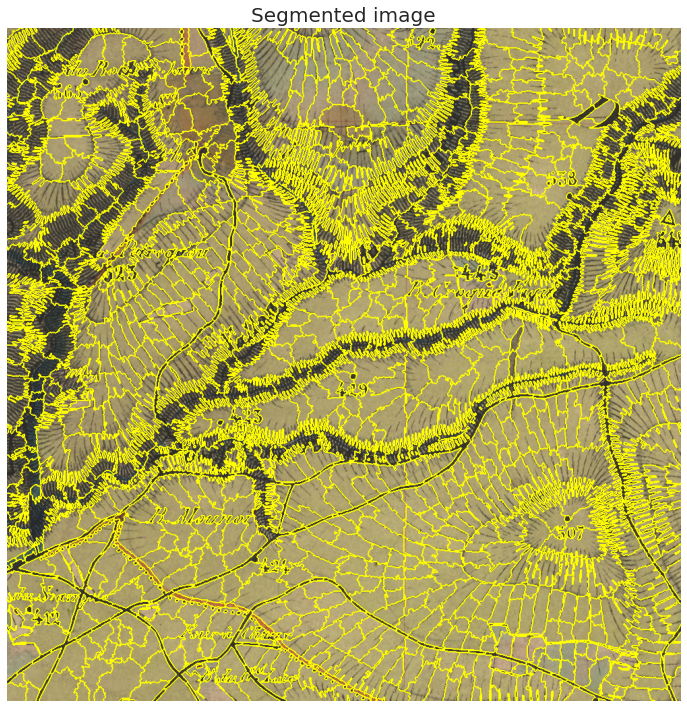

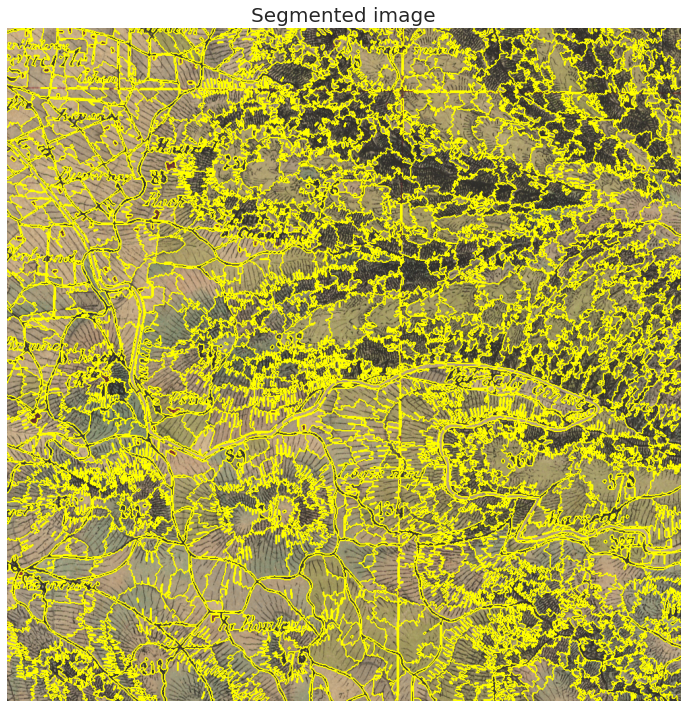

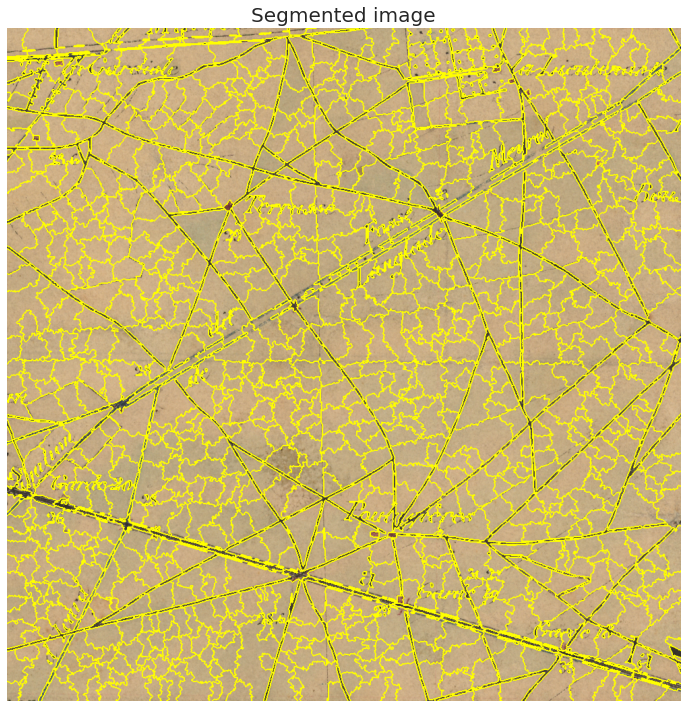

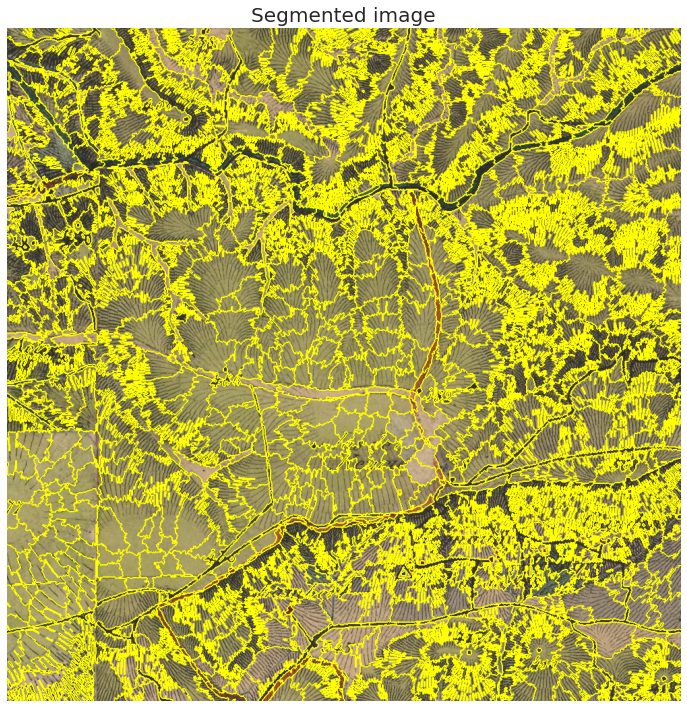

In [ ]:
# Displays 5 images and labels
for i in np.random.choice(range(len(images_test)), 5, replace=False):
    print(i)
    #Had to add in these squeezes in order to not get an error
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    compare(images=[p, q], titles=['Image', 'Label'])

# Displays image segmentation
for i in np.random.choice(range(len(images_test)), 5, replace=False):
    display(image=segmentation.mark_boundaries(images_test[i], np.squeeze(segments_test[i])), title='Segmented image')

# **2. Compute Input/Response**

In [ ]:
#%% COMPUTES INPUT
Xtrain = list(map(segment_median, images_train, segments_train))
Xtrain = np.row_stack(Xtrain)

#%% COMPUTES RESPONSE
ytrain = list(map(segment_argmax, labels_train, segments_train))
ytrain = np.hstack(ytrain)

<font color='red'>
Below, added by students:
</font>

In [ ]:
#%% COMPUTE TEST INPUT
Xtest = list(map(segment_median, images_test, segments_test))
Xtest = np.row_stack(Xtest)

#%% COMPUTE TEST RESPONSE
ytest = list(map(segment_argmax, labels_test, segments_test))
ytest = np.hstack(ytest)

In [ ]:
# Value counts to predict
print(np.unique(ytrain))
print(np.unique(ytest))

[0 1 2 3 4 5 6 7 8]
[0 1 2 3 4 5 6 7 8]


In the above, we are not sure how an 8 got in there. In all of our predictions 8 is never accounted for, and the labels should be 0-7.

(array([156387.,  15976., 141794.,   9347.,      0., 119277.,  61298.,
         63906.,  24494.,   1166.]),
 array([0. , 0.8, 1.6, 2.4, 3.2, 4. , 4.8, 5.6, 6.4, 7.2, 8. ]),
 <a list of 10 Patch objects>)

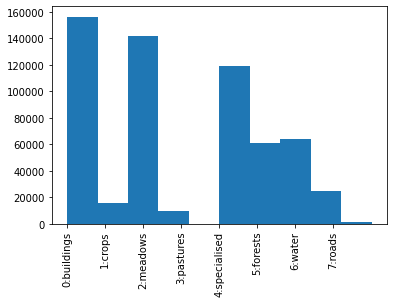

In [ ]:
#Set x-ticks
classes = {1:'0:buildings', 2:'1:crops', 3:'2:meadows', 4:'3:pastures', 5:'4:specialised', 6:'5:forests', 7:'6:water', 8:'7:roads'}
keys, values = classes.keys(), classes.values()

# Display histo
_ = plt.hist(ytrain)
plt.xticks(range(len(keys)), values, rotation= 90)
_

<font color='red'>
So, from the histogram above, we are dealing with a multiclass class imbalance problem
</font>

# **3. Naïve Random Forest Classification**

Here we attempt a Random Forest to classify images. With Random Forest, our main parameters are:

+ *n_estimators*: Number of trees to build
+ *max_features*: Number of features to consider when looking for the best split. If less than 100%, this intruduces stochasticity.
+ *bootstrap*: Keep default 'True' to allow boostrapping the sample for each tree, useful to prevent overfitting
+ *oob_score*: If True, yields a proxy for expected accuracy, using *out of bag* observations per tree.

We will first run a naive classification and then look to optimize.


CPU times: user 1min 39s, sys: 4.57 s, total: 1min 43s
Wall time: 1min 2s


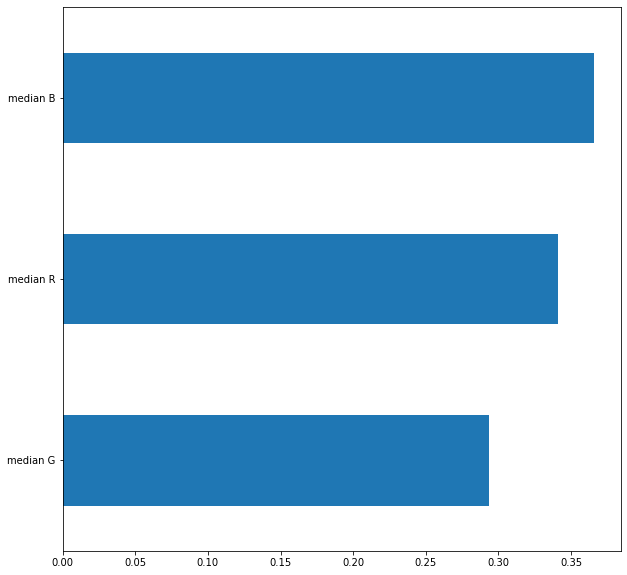

In [ ]:
%%time
# Prepares data
keep   = np.where(ytrain != 0)
Xtrain = Xtrain[keep]
ytrain = ytrain[keep]
del(keep)

# Estimates model
rf = ensemble.RandomForestClassifier(n_estimators=100, oob_score=True, n_jobs=-1)
rf.fit(Xtrain, ytrain)
#del(Xtrain, ytrain)

# OOB statistic
rf.oob_score_ # Note: OOB is not reliable because superpixels are different in size

# Variable importance
importance = pd.Series(rf.feature_importances_, index=['median R', 'median G', 'median B'])
importance = importance.sort_values(ascending=True)
importance.plot(kind='barh', figsize=(10, 10))
del(importance)

## 3.1 Predictions

In [ ]:
df, target = Xtrain, ytrain


In [ ]:
cvs = cross_val_score(rf, 
                      df, 
                      target, 
                      scoring = 'roc_auc_ovr', 
                      cv = 5)
print('Naïve Random Forest ROC AUC (Multiclass) scores are:', cvs)

Naïve Random Forest ROC AUC (Multiclass) scores are: [0.76339393 0.79986025 0.8205214  0.80224612 0.77908027]


In [ ]:
import warnings
warnings.filterwarnings("ignore")
# Predict
y_hat = rf.predict(Xtest)

# Classification report
print(classification_report(ytest, y_hat, target_names=class_labels_multi))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00     36571
           1       0.75      0.96      0.84      3412
           2       0.43      0.69      0.53     35008
           3       0.30      0.39      0.34      2097
           4       0.45      0.51      0.48     35653
           5       0.34      0.29      0.31     12313
           6       0.55      0.75      0.64     11368
           7       0.33      0.74      0.45      5129
           8       0.00      0.00      0.00       266

    accuracy                           0.44    141817
   macro avg       0.35      0.48      0.40    141817
weighted avg       0.33      0.44      0.37    141817



In [ ]:
# Report overall scores
print("Overall Accuracy:", accuracy_score(ytest, y_hat))
print("Overall Precision:", precision_score(ytest, y_hat, average='macro'))
print("Overall Recall:", recall_score(ytest, y_hat, average='macro'))

Overall Accuracy: 0.43964404831578724
Overall Precision: 0.3481738769718864
Overall Recall: 0.4808214609180062


In [ ]:
class_labels_multi = ['buildings', 'crops', 'meadows', 'pastures', 'specialised', 'forests', 'water', 'roads', 'NA']

We plotted the below confusion matrix using this [source](https://www.stackvidhya.com/plot-confusion-matrix-in-python-and-why/)

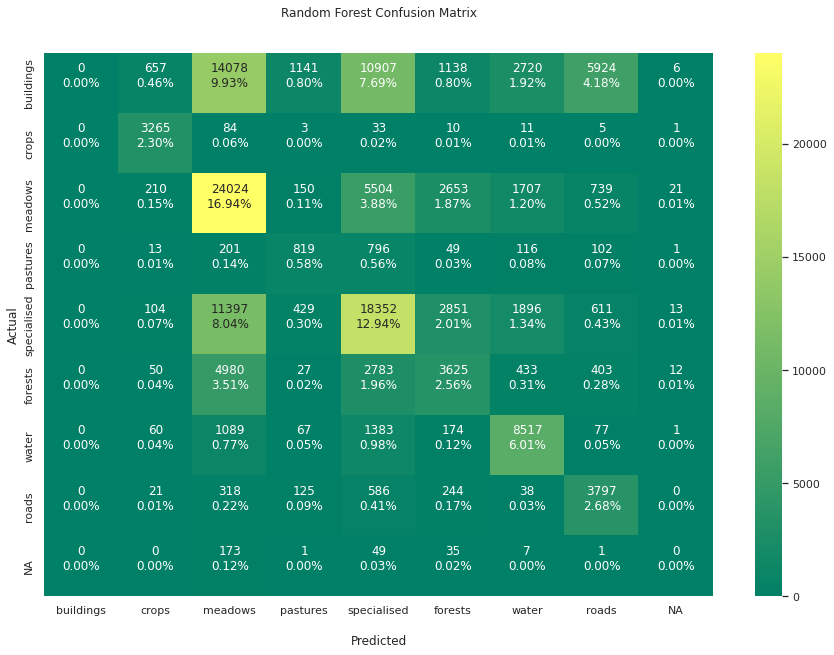

In [ ]:
cf_matrix =  confusion_matrix(ytest, y_hat)
cfmatrix(cf_matrix, ytest, y_hat)

It looks as though it did a decent job predicting crops and pastures, but overall does not look great

#### View Predicted Images

Image Number 18


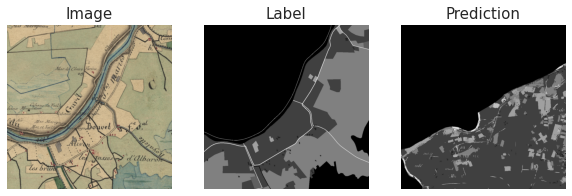

Image Number 19


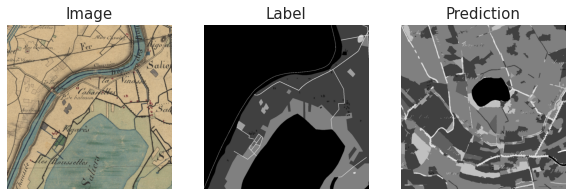

Image Number 28


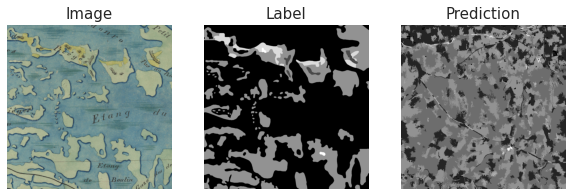

Image Number 16


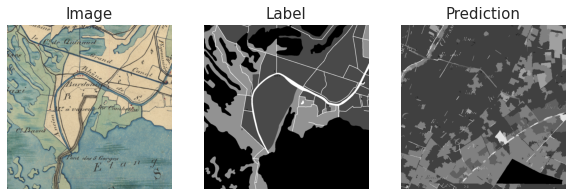

Image Number 53


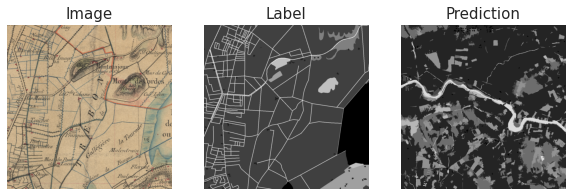

In [ ]:
def predict_image(image, segment, mask):
    X     = segment_median(image, segment)
    label = rf.predict(X)
    label = label[segment - 1]
    label = np.where(mask, label, 0)
    return label

labels_predict = list(map(predict_image, images_test, segments_test, masks_test))
labels_predict_rf = labels_predict

for i in np.random.choice(range(len(images_test)), 5, replace=False):
    print("Image Number", i)
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])

Not great predictions - will aim to improve

# **4. Random Forest Optimization**

## 4.1 Randomized Grid Search

To optimize the RF we ran a grid search. Note we always bootstrap here to account for class_imbalance, which means that they are drawn with replacement and some samples will be used several times. This will not create bias but will lower variance. 

In [ ]:
# RF 
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 200, num = 5)]
#max_leaf_nodes = [int(x) for x in np.linspace(1, 5, num = 5)]
max_leaf_nodes = [int(x) for x in np.linspace(2, 5, num = 4)]
min_impurity_decrease = [float(x) for x in np.linspace(0, 1, num = 5)]

rf_params = {'n_estimators': n_estimators,
             'max_leaf_nodes': max_leaf_nodes,
             'min_impurity_decrease': min_impurity_decrease}

In [ ]:
# Set data
#df, target = X_random, y_random
df, target = Xtrain, ytrain

# Start timer
start = datetime.now()

# Instantiate grid search
rf_random = RandomizedSearchCV(estimator = RandomForestClassifier(), 
                               param_distributions = rf_params, 
                               scoring = 'roc_auc_ovr',
                               n_iter=50, 
                               cv =2, 
                               verbose = 10, 
                               random_state=42, 
                               n_jobs = -1)

# Fit
rf_random.fit(df, target)

# Print runtime
print('Runtime:', datetime.now() - start); print('/n')

Fitting 2 folds for each of 50 candidates, totalling 100 fits
Runtime: 0:14:20.073005
/n


## 4.2 Estimate Best Estimator

In [ ]:
# Estimates model
rf_opt = rf_random.best_estimator_
rf_opt.fit(Xtrain, ytrain)

RandomForestClassifier(max_leaf_nodes=5, n_estimators=87)

Now running the RandomForest with max_leaf_nodes=5, n_estimators=125

## 4.3 Prediction Accuracy

In [ ]:
cvs = cross_val_score(rf_opt, 
                      df, 
                      target, 
                      scoring = 'roc_auc_ovr', 
                      cv = 5)
print('Naïve Random Forest ROC AUC (Multiclass) scores are:', cvs)

Naïve Random Forest ROC AUC (Multiclass) score is: [0.68731042 0.74186321 0.7605655  0.72228971 0.68516338]


In [ ]:
import warnings
warnings.filterwarnings("ignore")
# Predict
y_hat = rf_opt.predict(Xtest)

# Classification report
print(classification_report(ytest, y_hat, target_names=class_labels_multi))

              precision    recall  f1-score   support

   buildings       0.55      0.36      0.43     36571
       crops       0.00      0.00      0.00      3412
     meadows       0.32      0.81      0.46     35008
    pastures       0.00      0.00      0.00      2097
 specialised       0.31      0.23      0.26     35653
     forests       0.00      0.00      0.00     12313
       water       0.74      0.18      0.29     11368
       roads       0.00      0.00      0.00      5129
          NA       0.00      0.00      0.00       266

    accuracy                           0.36    141817
   macro avg       0.21      0.18      0.16    141817
weighted avg       0.36      0.36      0.31    141817



In [ ]:
# Report overall scores
print("Overall Accuracy:", accuracy_score(ytest, y_hat))
print("Overall Precision:", precision_score(ytest, y_hat, average='macro'))
print("Overall Recall:", recall_score(ytest, y_hat, average='macro'))

Overall Accuracy: 0.36494919508944623
Overall Precision: 0.21291659692436093
Overall Recall: 0.17573916788935318


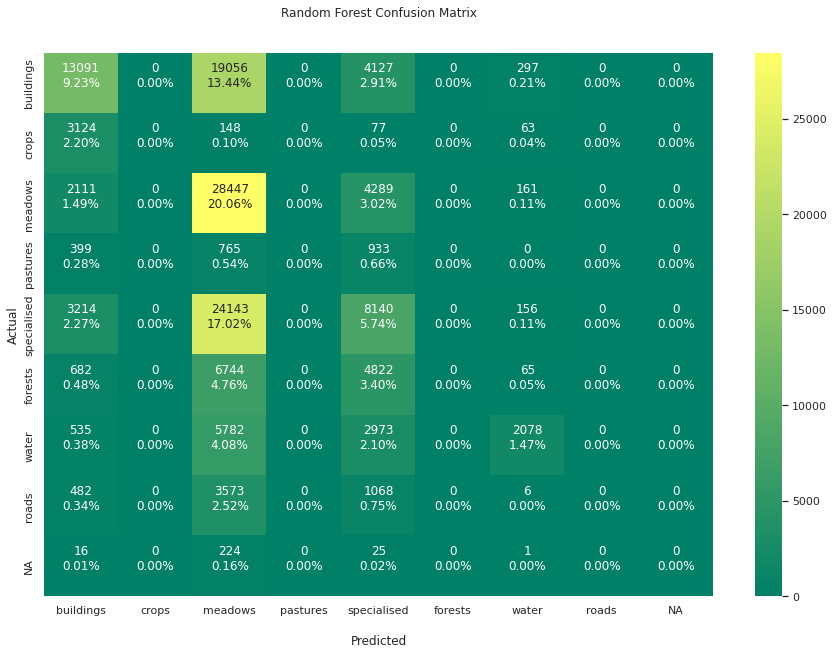

In [ ]:
cf_matrix2 =  confusion_matrix(ytest, y_hat)
cfmatrix(cf_matrix2, ytest, y_hat)

This lowered the scores dramatically. Will need to try alternative methods

Image Number 16


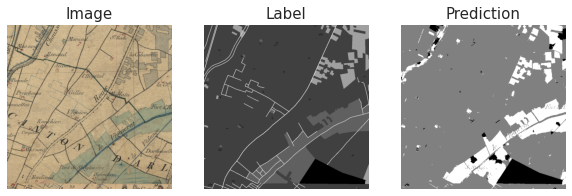

Image Number 70


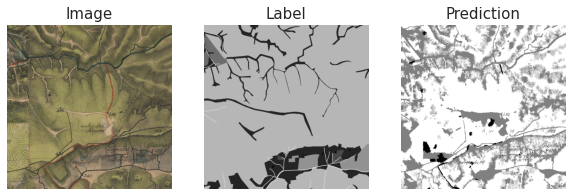

Image Number 57


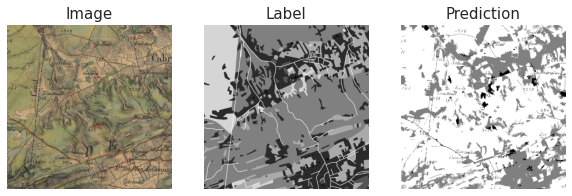

Image Number 39


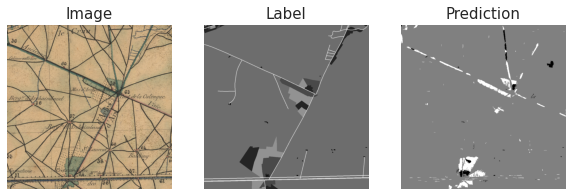

Image Number 76


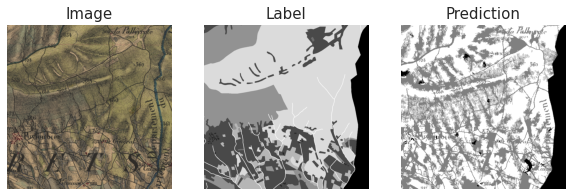

In [ ]:
def predict_image(image, segment, mask):
    X     = segment_median(image, segment)
    label = rf_opt.predict(X)
    label = label[segment - 1]
    label = np.where(mask, label, 0)
    return label

labels_predict = list(map(predict_image, images_test, segments_test, masks_test))
labels_predict_rfopt = labels_predict

for i in np.random.choice(range(len(images_test)), 5, replace=False):
    print("Image Number", i)
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_rfopt[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])

However, the predictions look pretty good.

# **5. XGBoost**

Here we attempt an XGBoost(Extreme Gradient Boosting).

It is technically an ensemble technique but isn't obviously so. Models are trained consecutively until it can no longer improve.

The eta parameter can be used to help prevent overfitting. This is also known as the learning rate, which is .05 below.

Documentation: https://xgboost.readthedocs.io/en/latest/python/python_intro.html#prediction

In [ ]:
%%time
# Prepares data
keep   = np.where(ytrain != 0)
Xtrain = Xtrain[keep]
ytrain = ytrain[keep]
del(keep)

# Estimates model
xgb = XGBClassifier()
xgb.fit(Xtrain, ytrain)

CPU times: user 1min 47s, sys: 236 ms, total: 1min 48s
Wall time: 1min 48s


In [ ]:
cvs = cross_val_score(xgb, 
                      df, 
                      target, 
                      scoring = 'roc_auc_ovr', 
                      cv = 5)
print('Naïve XGB ROC AUC (Multiclass) score is:', cvs)

Naïve XGB ROC AUC (Multiclass) score is: [0.78158859 0.82361711 0.85990147 0.8534414  0.83032681]


In [ ]:
import warnings
warnings.filterwarnings("ignore")

# Predict
y_hat_xgb = xgb.predict(Xtest)

# Classification report
print(classification_report(ytest, y_hat_xgb, target_names=class_labels_multi))

              precision    recall  f1-score   support

   buildings       0.00      0.00      0.00     36571
       crops       0.71      0.92      0.80      3412
     meadows       0.37      0.78      0.50     35008
    pastures       0.23      0.23      0.23      2097
 specialised       0.40      0.44      0.42     35653
     forests       0.42      0.10      0.16     12313
       water       0.64      0.48      0.55     11368
       roads       0.38      0.75      0.50      5129
          NA       0.00      0.00      0.00       266

    accuracy                           0.40    141817
   macro avg       0.35      0.41      0.35    141817
weighted avg       0.31      0.40      0.33    141817



In [ ]:
# Report overall scores
print("Overall Accuracy:", accuracy_score(ytest, y_hat_xgb))
print("Overall Precision:", precision_score(ytest, y_hat_xgb, average='macro'))
print("Overall Recall:", recall_score(ytest, y_hat_xgb, average='macro'))

Overall Accuracy: 0.4019334776507753
Overall Precision: 0.34991395844372264
Overall Recall: 0.4103286635756134


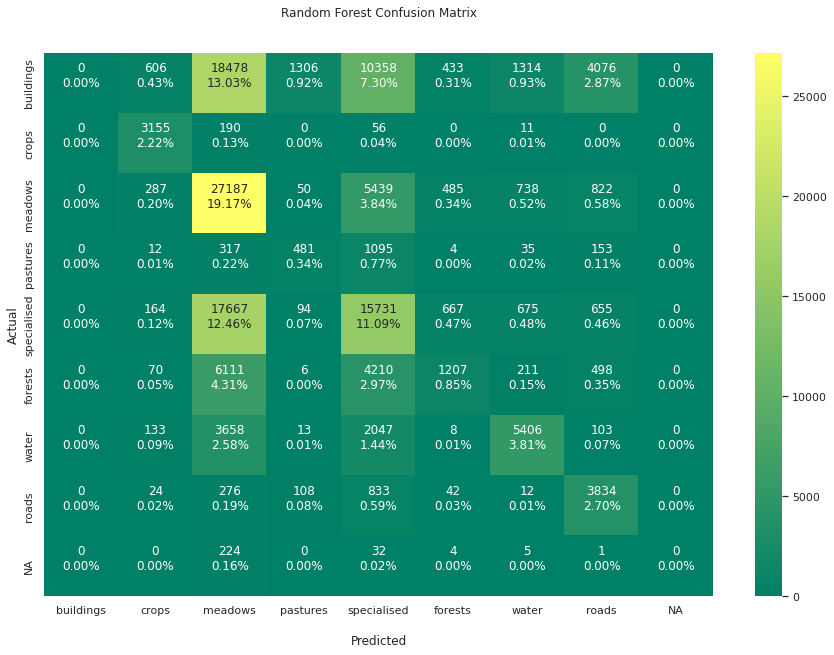

In [ ]:
cf_matrix3 =  confusion_matrix(ytest, y_hat_xgb)
cfmatrix(cf_matrix3, ytest, y_hat_xgb)

This performed much better, successfully predicting water, specialised, and forests quite a bit more often. Can visualize the maps below.

Image Number 0


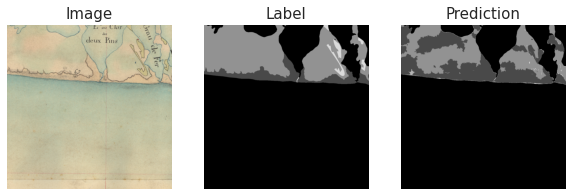

Image Number 18


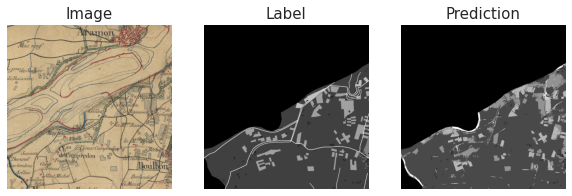

Image Number 50


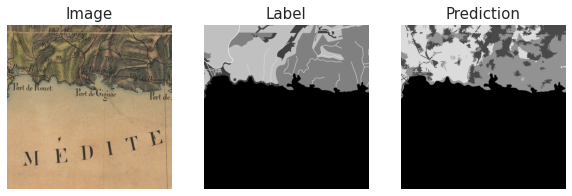

Image Number 46


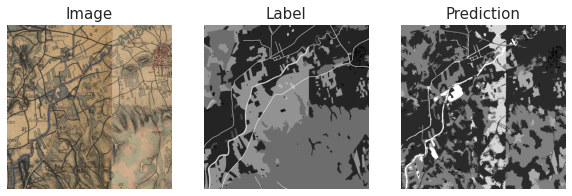

Image Number 61


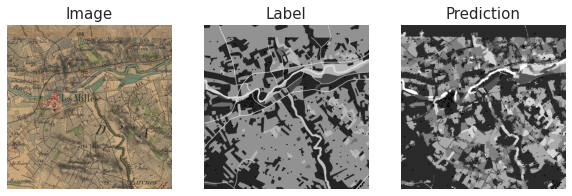

In [ ]:
def predict_image(image, segment, mask):
    X     = segment_median(image, segment)
    label = xgb.predict(X)
    label = label[segment - 1]
    label = np.where(mask, label, 0)
    return label

labels_predict = list(map(predict_image, images_test, segments_test, masks_test))
labels_predict_xgb = labels_predict

for i in np.random.choice(range(len(images_test)), 5, replace=False):
    print("Image Number", i)
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])

# **6. Grid Searching Estimators**

Here I will run a randomized grid search to determine some optimal parameters for decision trees, random forests, adaboost, gradient boost, and xgboost.

I don't expect decision trees to win and ideally would optimize more parameters however this takes over 3 hours to run 

In [ ]:
# DT
#max_leaf_nodes = [int(x) for x in np.linspace(1, 5, num = 5)]
max_leaf_nodes = [int(x) for x in np.linspace(2, 5, num = 4)]
min_impurity_decrease = [float(x) for x in np.linspace(0, 1, num = 5)]

dt_params = {'max_leaf_nodes': max_leaf_nodes,
             'min_impurity_decrease': min_impurity_decrease}

# RF 
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 200, num = 5)]
#max_leaf_nodes = [int(x) for x in np.linspace(1, 5, num = 5)]
max_leaf_nodes = [int(x) for x in np.linspace(2, 5, num = 4)]
min_impurity_decrease = [float(x) for x in np.linspace(0, 1, num = 5)]

rf_params = {'n_estimators': n_estimators,
             'max_leaf_nodes': max_leaf_nodes,
             'min_impurity_decrease': min_impurity_decrease}

# AdaBoost
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 200, num = 5)]
#learning_rate = [float(x) for x in np.linspace(0, 1, num = 5)]
learning_rate = [float(x) for x in np.linspace(0.1, 1, num = 5)]

ada_params = {'n_estimators': n_estimators,
              'learning_rate': learning_rate,}

# Gradient Boost
gboost_params = ada_params


# XGBoost
xgb_params = {'num_boost_round': [10, 25, 50],
              'eta': [0.05, 0.1, 0.3],
              #'subsample': [0.9, 1.0],
              #'colsample_bytree': [0.9, 1.0],
              'max_depth': [3, 4, 5]}


# Create iterator
names = ['Decision Tree', 'Random Forest', 'AdaBoost', 'Gradient Boost', 'XGBoost']
classifiers = [DecisionTreeClassifier(),
              RandomForestClassifier(),
              AdaBoostClassifier(),
              GradientBoostingClassifier(),
              xgboost.XGBClassifier()]
params = [dt_params, 
          rf_params, 
          ada_params, 
          gboost_params,
          xgb_params]

print(params)
regs_clf = zip(names, classifiers, params)

[{'max_leaf_nodes': [2, 3, 4, 5], 'min_impurity_decrease': [0.0, 0.25, 0.5, 0.75, 1.0]}, {'n_estimators': [50, 87, 125, 162, 200], 'max_leaf_nodes': [2, 3, 4, 5], 'min_impurity_decrease': [0.0, 0.25, 0.5, 0.75, 1.0]}, {'n_estimators': [50, 87, 125, 162, 200], 'learning_rate': [0.1, 0.325, 0.55, 0.775, 1.0]}, {'n_estimators': [50, 87, 125, 162, 200], 'learning_rate': [0.1, 0.325, 0.55, 0.775, 1.0]}, {'num_boost_round': [10, 25, 50], 'eta': [0.05, 0.1, 0.3], 'max_depth': [3, 4, 5]}]


In [ ]:
# Start timer
start = datetime.now()

# Set data
df, target = Xtrain, ytrain

best_ests = []
# Run grid search over different estimators and report metrics
for name, reg, param in regs_clf:
  # Instantiate grid
  grid = RandomizedSearchCV(estimator = reg, 
                       param_distributions = param,
                       scoring = 'roc_auc_ovr',
                       cv = 2,
                       n_iter = 25,
                       n_jobs = -1,
                       verbose = 0)
  
  # Fit grid and calc score
  grid.fit(df, target)
  cvs = cross_val_score(reg, df, target, scoring = 'roc_auc_ovr', cv = 5)
  
  # Save results
  best_ests.append((name, grid.best_estimator_, cvs))

# Print runtime
print('Runtime:', datetime.now() - start); print('/n')

# Print winner
print(best_ests.sort(key = lambda x: x[1]))
print('And the winner is:', best_ests[0][0], 'with a AUC score of {:0.2f}'.format(best_ests[0][2]))
print('Best model was', best_ests[0][1])

Runtime: 4:48:58.962979
/n


TypeError: ignored

The above ran for nearly 5 hours and had an error in the final print, but I was able to salvage the predictions below.

In [ ]:
best_ests

[('Decision Tree',
  DecisionTreeClassifier(max_leaf_nodes=5),
  array([0.69349141, 0.72635171, 0.76434194, 0.76135325, 0.75132783])),
 ('Random Forest',
  RandomForestClassifier(max_leaf_nodes=4, n_estimators=50),
  array([0.7745697 , 0.80070327, 0.83503876, 0.83541861, 0.82518626])),
 ('AdaBoost',
  AdaBoostClassifier(n_estimators=162),
  array([0.63656842, 0.67208569, 0.7193706 , 0.69627703, 0.67558198])),
 ('Gradient Boost',
  GradientBoostingClassifier(learning_rate=0.325, n_estimators=125),
  array([0.78903142, 0.83490158, 0.87102415, 0.86402131, 0.84807403])),
 ('XGBoost', XGBClassifier(eta=0.05, max_depth=5, num_boost_round=10,
                objective='multi:softprob'), array([0.78158859, 0.82361711, 0.85990147, 0.8534414 , 0.83032681]))]


```
[('Decision Tree',
  DecisionTreeClassifier(max_leaf_nodes=5),
  array([0.69349141, 0.72635171, 0.76434194, 0.76135325, 0.75132783])),
 ('Random Forest',
  RandomForestClassifier(max_leaf_nodes=4, n_estimators=50),
  array([0.7745697 , 0.80070327, 0.83503876, 0.83541861, 0.82518626])),
 ('AdaBoost',
  AdaBoostClassifier(n_estimators=162),
  array([0.63656842, 0.67208569, 0.7193706 , 0.69627703, 0.67558198])),
 ('Gradient Boost',
  GradientBoostingClassifier(learning_rate=0.325, n_estimators=125),
  array([0.78903142, 0.83490158, 0.87102415, 0.86402131, 0.84807403])),
 ('XGBoost', XGBClassifier(eta=0.05, max_depth=5, num_boost_round=10,
                objective='multi:softprob'), array([0.78158859, 0.82361711, 0.85990147, 0.8534414 , 0.83032681]))]
```


From the above, our best estimator is the Gradient Boosting classifier. However, the XGBoost is close in performance. We first run the XGBoost with the specified hyperparameters.

In [ ]:
xgb = XGBClassifier(eta=0.05, max_depth=5, num_boost_round=10,
                objective='multi:softprob')

xgb.fit(Xtrain, ytrain)

import warnings
warnings.filterwarnings("ignore")

# Predict
y_hat_xgb2 = xgb.predict(Xtest)

# Classification report
print(classification_report(ytest, y_hat_xgb2, target_names=class_labels_multi))

              precision    recall  f1-score   support

   buildings       0.00      0.00      0.00     36571
       crops       0.73      0.97      0.84      3412
     meadows       0.43      0.75      0.54     35008
    pastures       0.34      0.32      0.33      2097
 specialised       0.45      0.51      0.48     35653
     forests       0.44      0.19      0.26     12313
       water       0.51      0.69      0.58     11368
       roads       0.33      0.80      0.47      5129
          NA       0.00      0.00      0.00       266

    accuracy                           0.44    141817
   macro avg       0.36      0.47      0.39    141817
weighted avg       0.33      0.44      0.37    141817



 Comparison:



ORIGINAL XGBOOST:
```
              precision    recall  f1-score   support

   buildings       0.00      0.00      0.00     36571
       crops       0.71      0.92      0.80      3412
     meadows       0.37      0.78      0.50     35008
    pastures       0.23      0.23      0.23      2097
 specialised       0.40      0.44      0.42     35653
     forests       0.42      0.10      0.16     12313
       water       0.64      0.48      0.55     11368
       roads       0.38      0.75      0.50      5129
          NA       0.00      0.00      0.00       266

    accuracy                           0.40    141817
   macro avg       0.35      0.41      0.35    141817
weighted avg       0.31      0.40      0.33    141817
```
NEW XGBOOST:
```
              precision    recall  f1-score   support

   buildings       0.00      0.00      0.00     36571
       crops       0.73      0.97      0.84      3412
     meadows       0.43      0.75      0.54     35008
    pastures       0.34      0.32      0.33      2097
 specialised       0.45      0.51      0.48     35653
     forests       0.44      0.19      0.26     12313
       water       0.51      0.69      0.58     11368
       roads       0.33      0.80      0.47      5129
          NA       0.00      0.00      0.00       266

    accuracy                           0.44    141817
   macro avg       0.36      0.47      0.39    141817
weighted avg       0.33      0.44      0.37    141817
```

Notice XGBoost is not correctly predicting any buildings at all

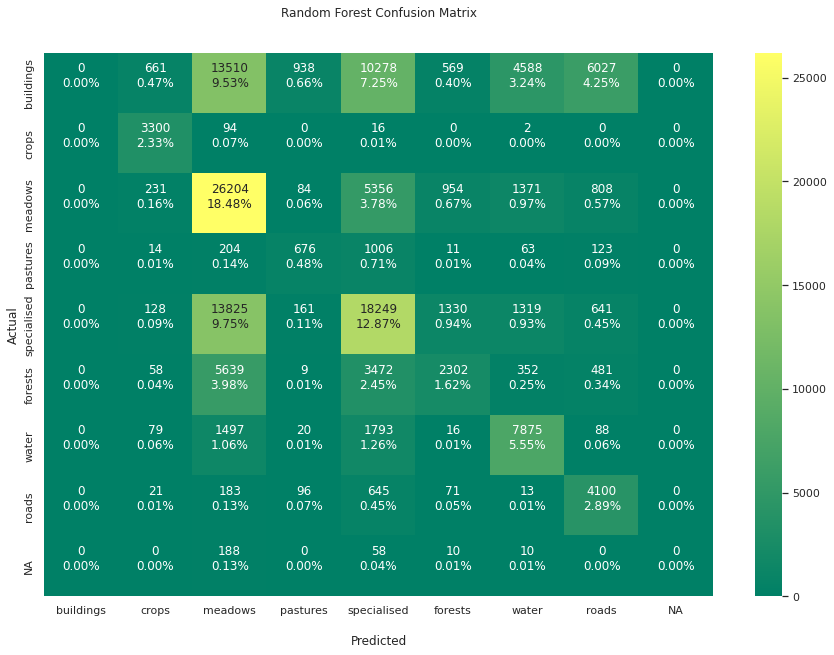

In [ ]:
cf_matrix_xgb =  confusion_matrix(ytest, y_hat_xgb2)
cfmatrix(cf_matrix_xgb, ytest, y_hat_xgb2)

Our predictions did not improve by much. They improved in every category but decrease for crops and water and did not improve water, and continue not to predict buildings.

# **7. Gradient Boosting Classifier**



In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

gbc = GradientBoostingClassifier(learning_rate=0.325, n_estimators=125)

gbc.fit(Xtrain, ytrain)

import warnings
warnings.filterwarnings("ignore")

# Predict
y_hat_gbc = gbc.predict(Xtest)

# Classification report
print(classification_report(ytest, y_hat_gbc, target_names=class_labels_multi))

              precision    recall  f1-score   support

   buildings       0.00      0.00      0.00     36571
       crops       0.75      0.97      0.84      3412
     meadows       0.43      0.75      0.55     35008
    pastures       0.32      0.27      0.29      2097
 specialised       0.45      0.51      0.48     35653
     forests       0.43      0.22      0.29     12313
       water       0.50      0.72      0.59     11368
       roads       0.35      0.77      0.48      5129
          NA       0.00      0.00      0.00       266

    accuracy                           0.44    141817
   macro avg       0.36      0.47      0.39    141817
weighted avg       0.33      0.44      0.37    141817



Saw very little improvement here as well, with the scores being slightly better but not much different. Continuing not to predict buildings.

Image Number 74


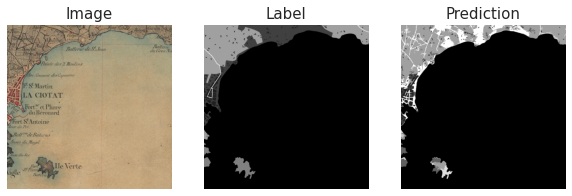

Image Number 8


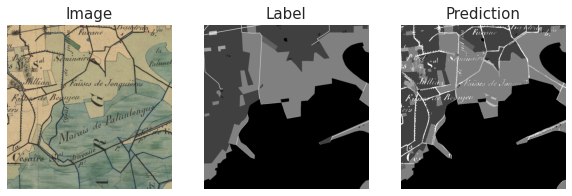

Image Number 38


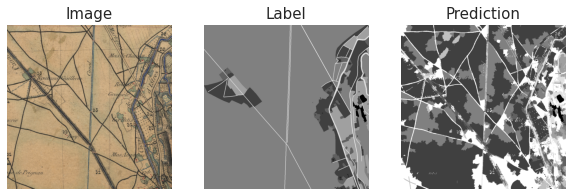

Image Number 40


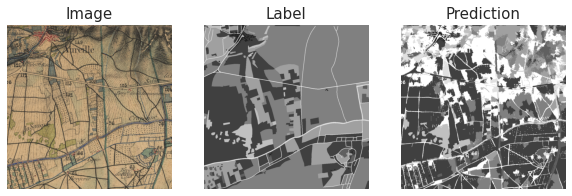

Image Number 41


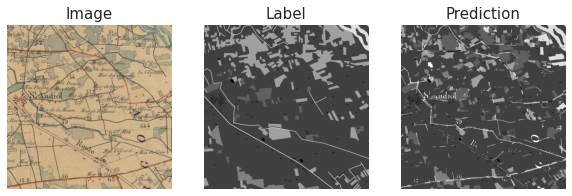

In [ ]:
def predict_image(image, segment, mask):
    X     = segment_median(image, segment)
    label = gbc.predict(X)
    label = label[segment - 1]
    label = np.where(mask, label, 0)
    return label

labels_predict = list(map(predict_image, images_test, segments_test, masks_test))
labels_predict_gbc = labels_predict

for i in np.random.choice(range(len(images_test)), 5, replace=False):
    print("Image Number", i)
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])

# **8. Class Imbalance**
We can also try reweighting to improve predictions

Here we create balanced class weights to improve the random forest model

In [ ]:
from  sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight('balanced', classes = np.unique(ytrain), y = np.ravel(ytrain))

cw = dict(zip(np.unique(ytrain), class_weights))
cw

rf_cw = RandomForestClassifier(n_estimators=100, max_leaf_nodes=4, 
                            class_weight = cw)

rf_cw.fit(Xtrain, ytrain)

import warnings
warnings.filterwarnings("ignore")

# Predict
y_hat_rfcw = rf_cw.predict(Xtest)

# Classification report
print(classification_report(ytest, y_hat_rfcw, target_names=class_labels_multi))

              precision    recall  f1-score   support

   buildings       0.46      0.50      0.48     36571
       crops       0.67      0.83      0.74      3412
     meadows       0.00      0.00      0.00     35008
    pastures       0.15      0.07      0.10      2097
 specialised       0.00      0.00      0.00     35653
     forests       0.00      0.00      0.00     12313
       water       0.00      0.00      0.00     11368
       roads       0.09      0.60      0.16      5129
          NA       0.00      0.79      0.01       266

    accuracy                           0.17    141817
   macro avg       0.15      0.31      0.17    141817
weighted avg       0.14      0.17      0.15    141817



This performed horribly! Perhaps because of the 9th unknown class that snuck into the data. We could drop that and perhaps see better results.

Image Number 49


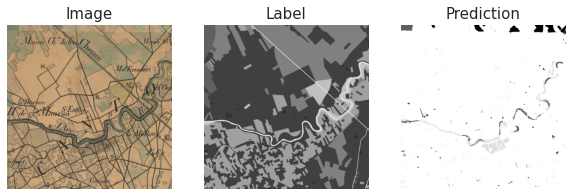

Image Number 42


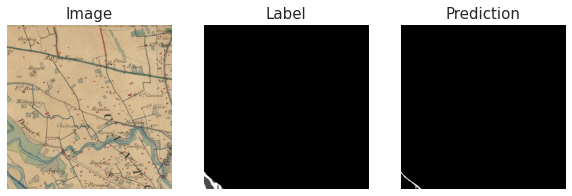

Image Number 66


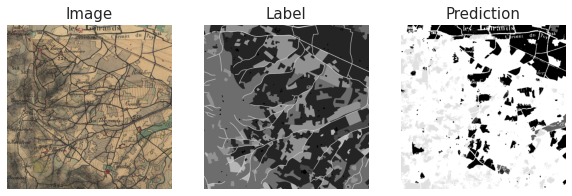

Image Number 75


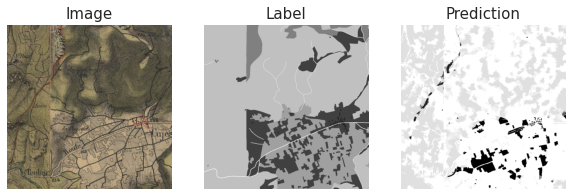

Image Number 79


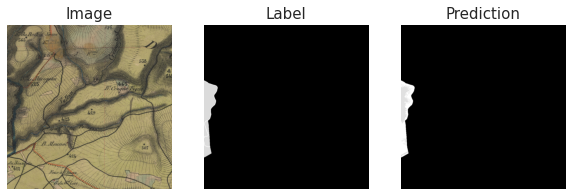

In [ ]:
def predict_image(image, segment, mask):
    X     = segment_median(image, segment)
    label = rf_cw.predict(X)
    label = label[segment - 1]
    label = np.where(mask, label, 0)
    return label

labels_predict = list(map(predict_image, images_test, segments_test, masks_test))
labels_predict_rfcw = labels_predict

for i in np.random.choice(range(len(images_test)), 5, replace=False):
    print("Image Number", i)
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])



##8.2 SMOTE

Smote is a technique to manage class imbalance. SMOTE than randomly oversampling because it creates synthetic data, so we don't have many identical data points with a standard oversampling method.

According to a Medium resource, the generation of synthetic data will work by first selecting random data from the minority class. Then, the Euclidean distance between the random data and its k nearest neighbors will be calculated using k-nearest neighbor technique. Then, the difference will be multiplied with a random number between 0 and 1, then the result will be added to the minority class as a synthetic sample.

SMOTE will ideally reduce false negatives, but potentially increase recall (false positives) at the expense of precision (false negatives)

In [ ]:
import imblearn
from imblearn.over_sampling import (SMOTE, RandomOverSampler)
from imblearn.combine import SMOTEENN, SMOTETomek

In [ ]:
smoter = SMOTE(random_state=59, sampling_strategy='all', k_neighbors=5)
Xsmote, ysmote = smoter.fit_resample(Xtrain, ytrain)

gbc_sm = GradientBoostingClassifier(learning_rate=0.1, n_estimators=125)

gbc_sm.fit(Xsmote, ysmote)

import warnings
warnings.filterwarnings("ignore")

# Predict
y_hat_smote = gbc_sm.predict(Xtest)

# Classification report
print(classification_report(ytest, y_hat_smote, target_names=class_labels_multi))

              precision    recall  f1-score   support

   buildings       0.75      0.35      0.48     36571
       crops       0.68      0.98      0.81      3412
     meadows       0.44      0.43      0.43     35008
    pastures       0.15      0.58      0.24      2097
 specialised       0.63      0.21      0.31     35653
     forests       0.27      0.32      0.30     12313
       water       0.41      0.79      0.54     11368
       roads       0.40      0.80      0.53      5129
          NA       0.01      0.53      0.01       266

    accuracy                           0.40    141817
   macro avg       0.42      0.56      0.41    141817
weighted avg       0.55      0.40      0.42    141817



In [ ]:
def predict_image(image, segment, mask):
    X     = segment_median(image, segment)
    label = gbc_sm.predict(X)
    label = label[segment - 1]
    label = np.where(mask, label, 0)
    return label

labels_predict = list(map(predict_image, images_test, segments_test, masks_test))
labels_predict_smote = labels_predict

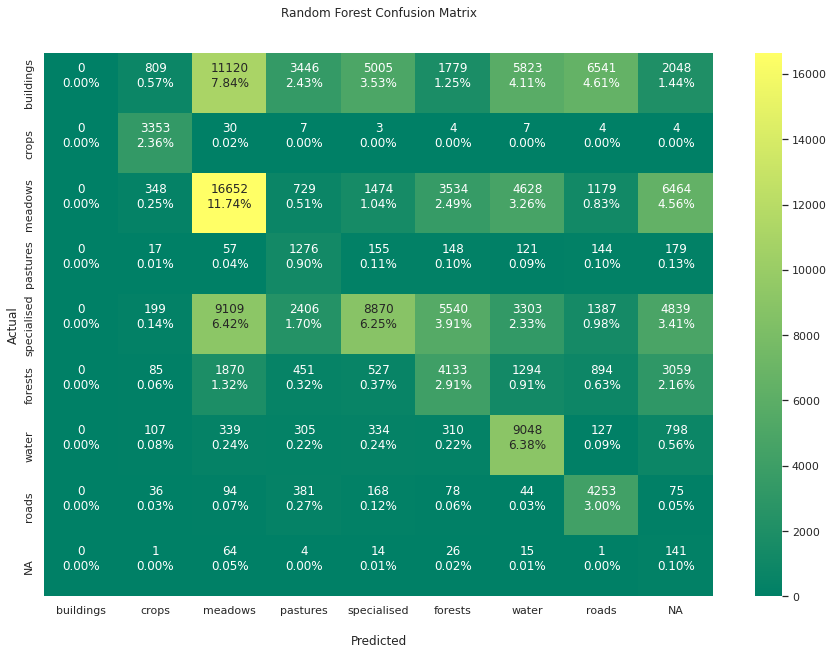

In [ ]:
cf_matrix_smote =  confusion_matrix(ytest, y_hat_smote)
cfmatrix(cf_matrix_smote, ytest, y_hat_smote)

F1 scores did not improve dramatically. However, the SMOTE allowed us to correctly pick up some buildings unlike the prior two classifiers that did not deal with class imbalance. This is a great improvement.

# Comparing all algorithms with one image

We thought it would be useful to compare all of the algorithms using the same image so we could pick a winner

In [ ]:
print("Naive Random Forest")
for i in images_test[16]:
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_rf[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])
print("Optimized Random Forest")
for i in images_test[16]:
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_rf_opt[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])

print('XGBoost:')
for i in images_test[16]:
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_xgb[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])

print('XGBoost SMOTE:')
for i in images_test[16]:
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_smote[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])

print('Gradient Booster:')
for i in images_test[16]:
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_gbc[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])

Naive Random Forest


TypeError: ignored

XGBoost:


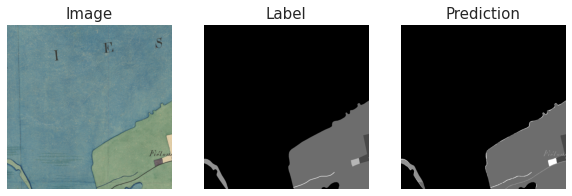

XGBoost SMOTE:


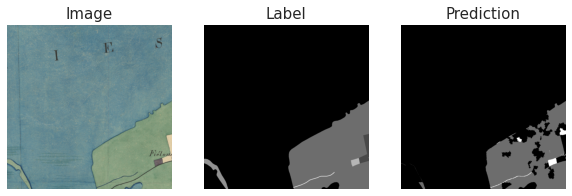

Gradient Booster:


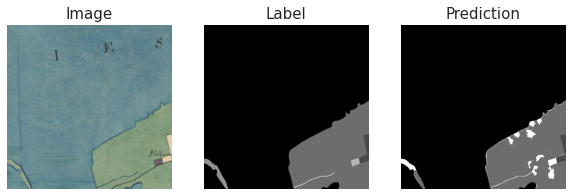

In [ ]:
for i in np.random.choice(range(len(images_test)), 1, replace=False):
    print('XGBoost:')
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_xgb[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])
    print('XGBoost SMOTE:')
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_smote[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])
    print('Gradient Booster:')
    p = np.squeeze(images_test[i])
    q = np.squeeze(labels_test[i])
    r = np.squeeze(labels_predict_gbc[i])
    compare(images=[p, q, r], titles=['Image', 'Label', 'Prediction'])
  


It's difficult to discern major differences, however it seems that the XGBoost performed best out of all of the images based on the above. This trial can of course be repeated with various images and will depend on how well that algorithm could pick up class imbalance.